# Création d'un dataset d'ordre de lecture sur PubLayNet

In [1]:
# !pip install Unidecode
# !pip install fuzzysearch

# !pip install elementpath
# !pip install lxml 
# !pip install graphviz
# !pip install pydotplus

In [3]:
!ls ../../../edspdf-train/data/publaynet/

dev.json xmls


In [15]:
import sys
sys.path.append('../')
import os
from pathlib import Path
import json
from sort_xml import *
import numpy as np
import pickle as pk

from edspdf import Pipeline
from edspdf.structures import Box, PDFDoc


base_dir = '../../../edspdf-train/data/publaynet/'

%load_ext autoreload
%autoreload 2

sys.executable

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


'/Users/souleymbaye/opt/anaconda3/envs/eds_env/bin/python'

In [63]:
import subprocess
import re

# Commande à exécuter
command = 'ls ../../../edspdf-train/data/publaynet/xmls'  # Cette commande liste les fichiers dans le répertoire courant (sur Unix/Linux/Mac)

# Exécution de la commande
process = subprocess.run(command, shell=True, capture_output=True, text=True, encoding='utf-8', errors='ignore')

# Récupération et affichage de la sortie
pmcs = process.stdout
pmcs = re.sub(r'\x1b\[.*?m', '', pmcs).splitlines()

print("Standard Output:")
print(pmcs[:5])


Standard Output:
['PMC1087887', 'PMC1087888', 'PMC1241820', 'PMC1247186', 'PMC1247188']


### Load pdf and xml names and info

In [13]:
xmls_dir = base_dir + 'xmls/'
dev_path = base_dir + 'dev.json'

with open(Path(dev_path)) as f:
    samples = json.load(f)

# load xml files
xmls_names = {} # {pmc = {xml_fname, pdf_fname}}
for root, directories, files in os.walk(xmls_dir):
    for pmc in directories:
        fdir = xmls_dir + pmc
        for root2, directories2, files2 in os.walk(fdir):
            xml_fname = None
            pdfs_fnames = []
            for file in files2:
                if file.split('.')[-1] == 'nxml':
                    xml_fname = file
                if file.split('.')[-1] == 'pdf':
                    pdfs_fnames.append(file)

            lenghts = [len(pf) for pf in pdfs_fnames]
            # if len(lenghts) == 0:
            #   print(f'fdir ==> {fdir}')

            i_min = np.argmin(lenghts)
            xmls_names[pmc] = {'xml' :xml_fname, 'pdf': pdfs_fnames[i_min], 'page_num': None}
    break
# end load xml files
    
    
for image in samples['images']:
    pmc = image['file_name'].split('_')[0]
    if pmc in xmls_names:
        page_num = int(image['file_name'].split('_')[1].split('.')[0])
        xmls_names[pmc]['page_num'] = page_num


In [14]:
print(f'Nb pmc {len(xmls_names)}')
for k,v in xmls_names.items():
    print(f'k: {k} -> v: {v}')
    break

Nb pmc 101
k: PMC1253713 -> v: {'xml': 'ehp0113-000073.nxml', 'pdf': 'ehp0113-000073.pdf', 'page_num': 3}


In [16]:
# model
model = Pipeline()
model.add_pipe("pdfminer-extractor", config=dict(extract_style="true"), name="extractor")

body nodes 34/34
front nodes 4/6
table 0 nodes 50/50
table 1 nodes 15/15
table 2 nodes 14/14
table 3 nodes 49/49
table 4 nodes 36/36
table 5 nodes 9/9
Nb pages 7


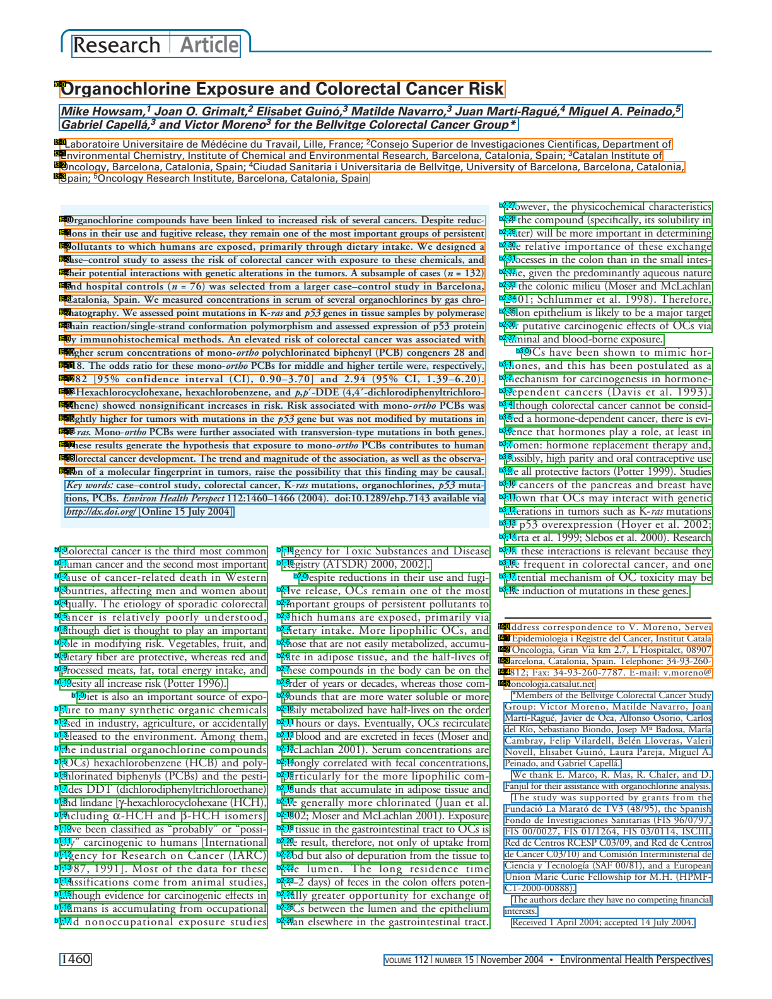

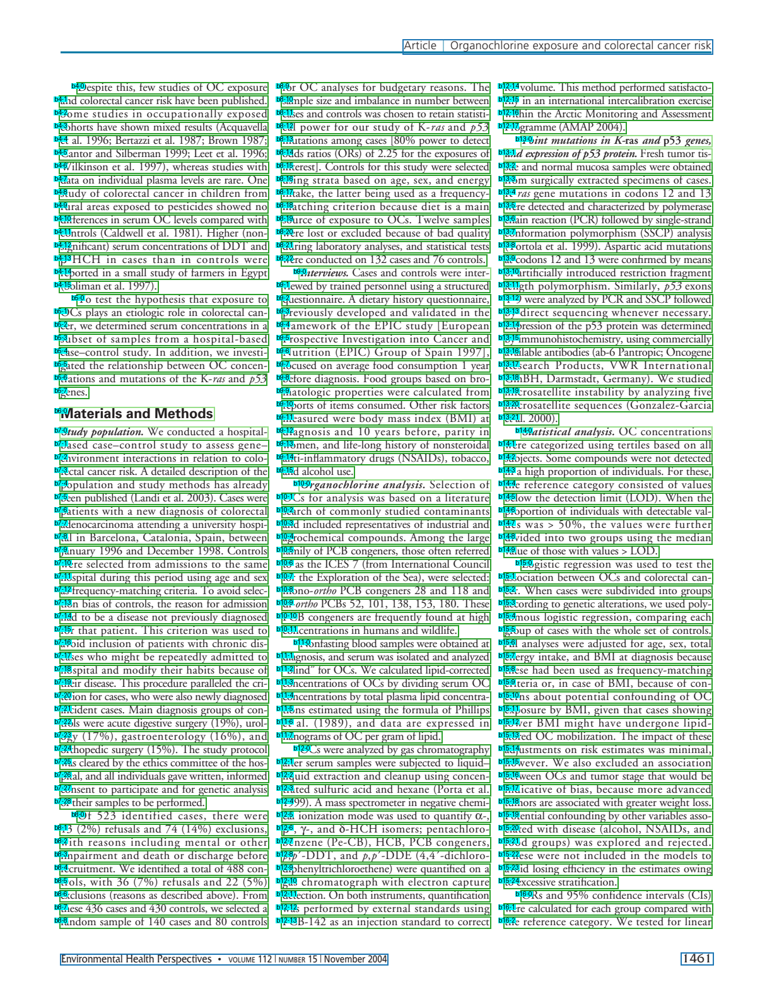

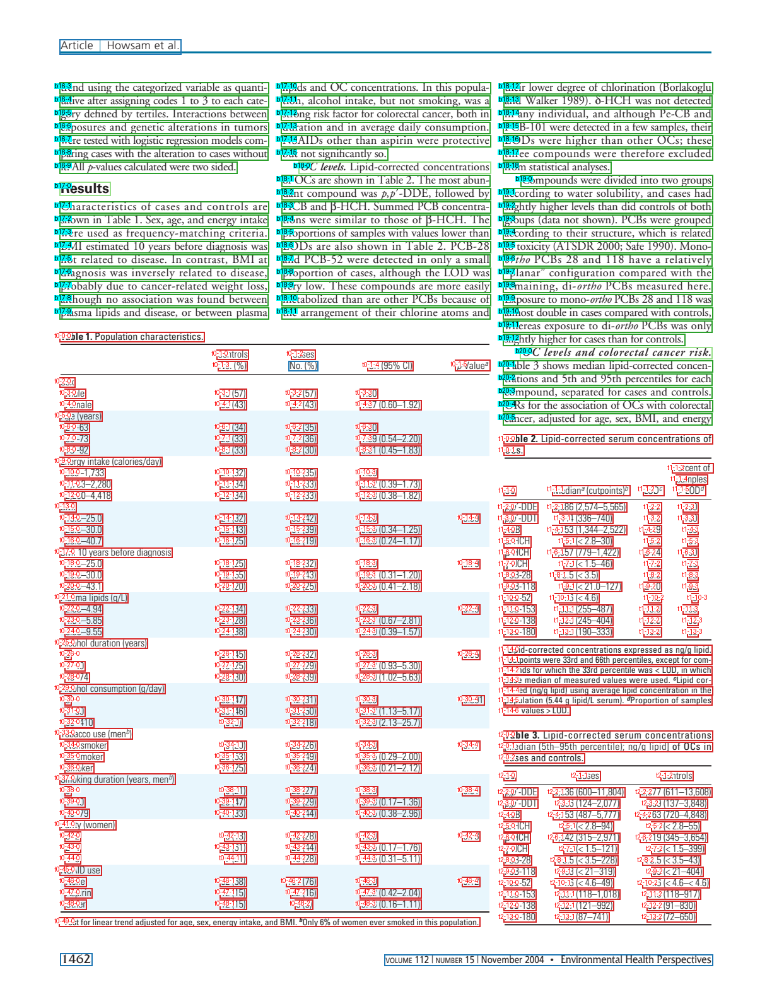

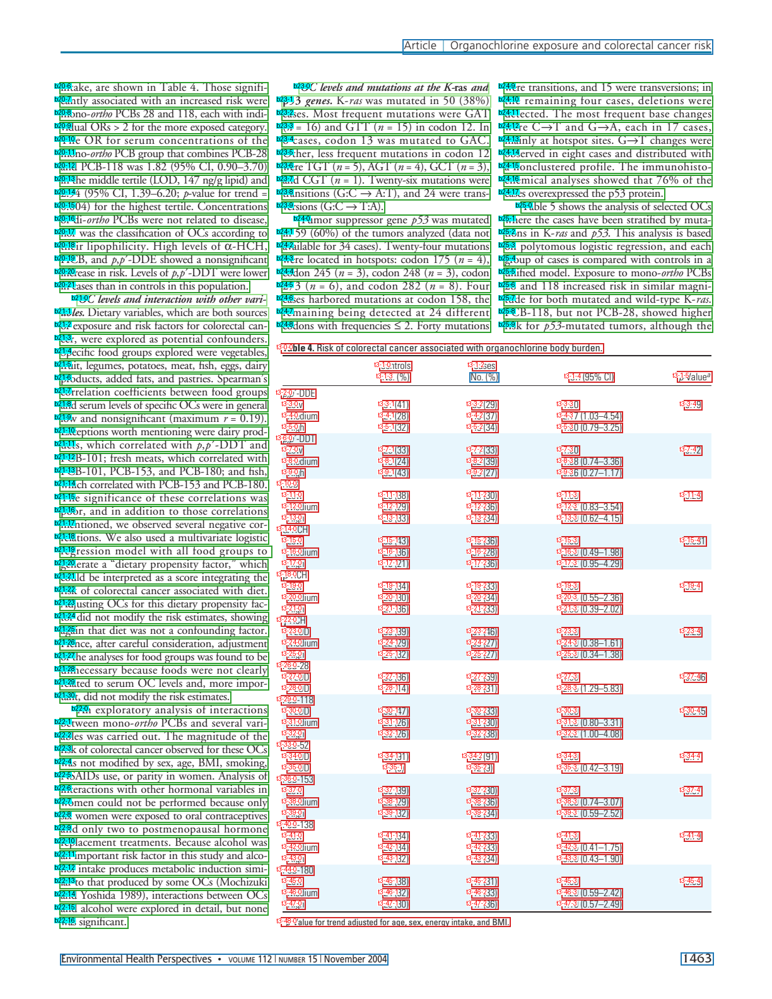

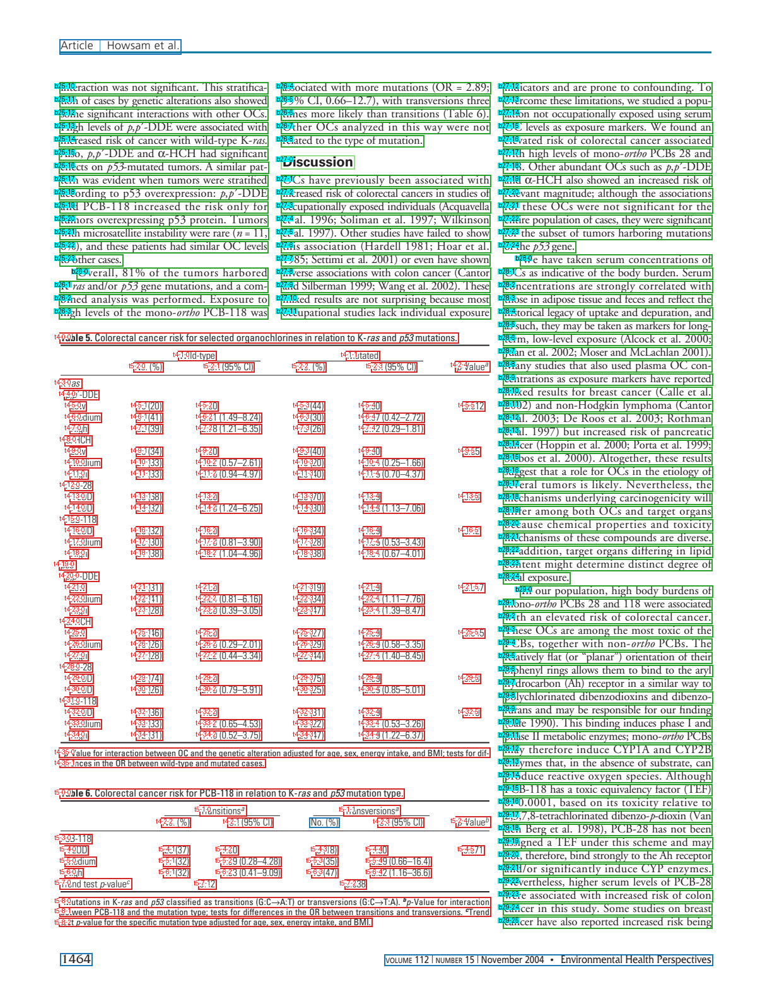

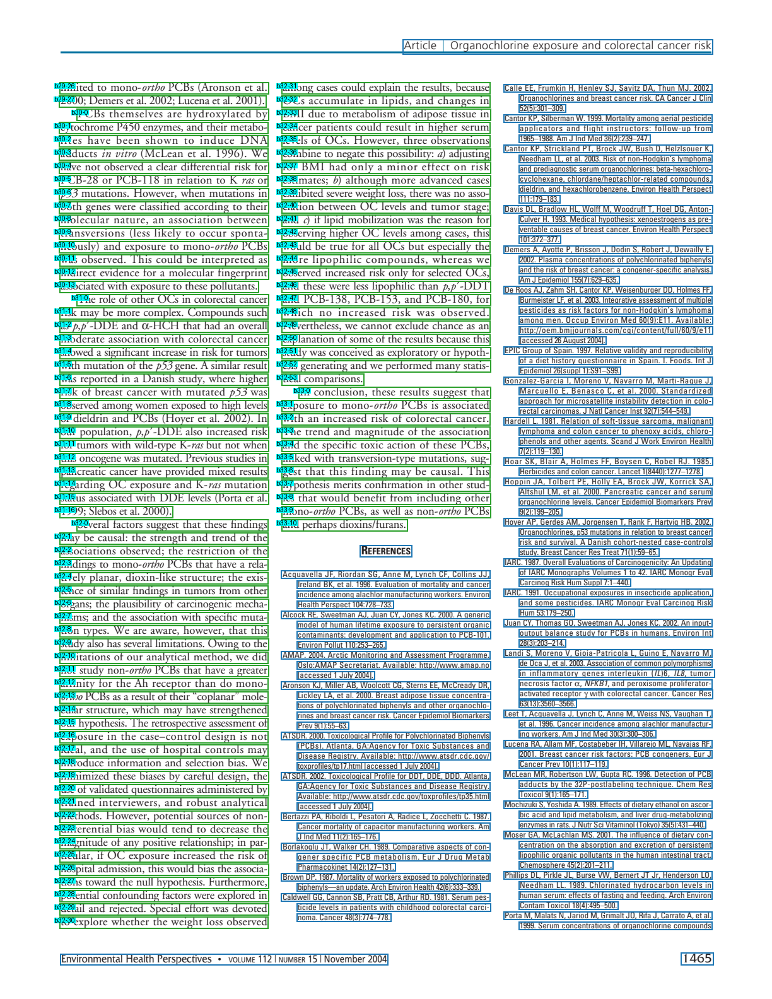

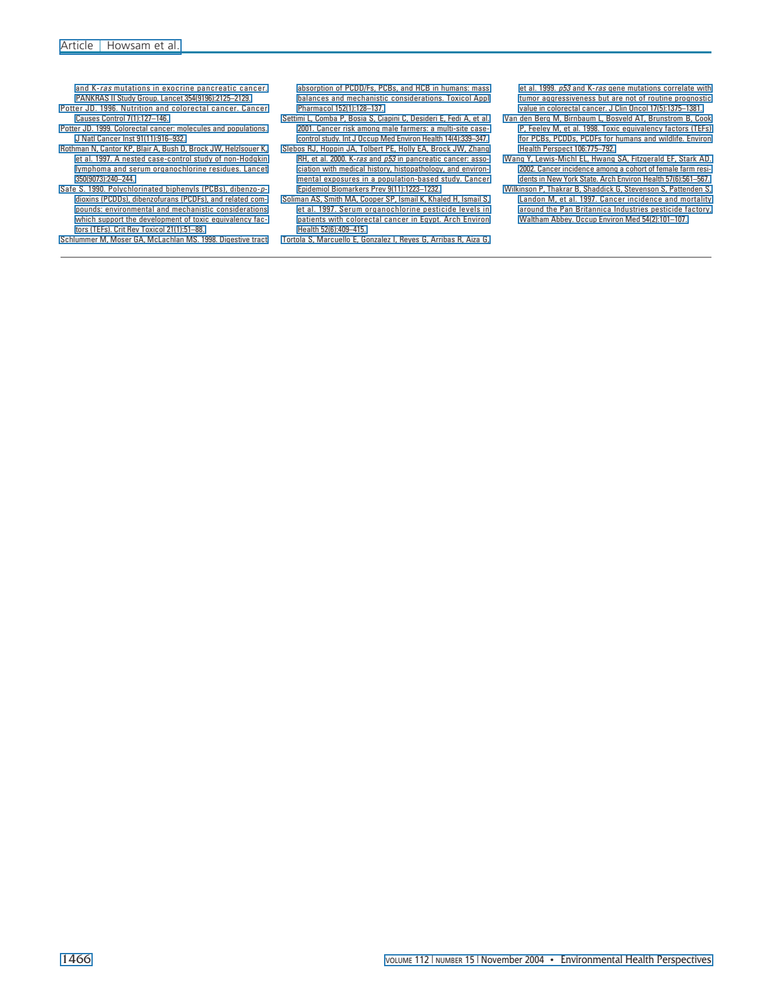

In [71]:
pmc = 'PMC1247607'
pmc_dir = xmls_dir + pmc

pmc_data, (doc,tree), (front_nodes, body_nodes, table_nodes) = match_pdf_xml_2_json(pmc_dir, model, v=True)

# save pk
pk_path = pmc_dir + '/' + 'pmc_data.pkl'
with open(pk_path, 'wb') as file:
    pk.dump(pmc_data, file)

In [82]:
with open(pk_path, 'rb') as file:
    loaded_pmc_data = pk.load(file)

## Display pdf(show annotation) with the loaded pkl file

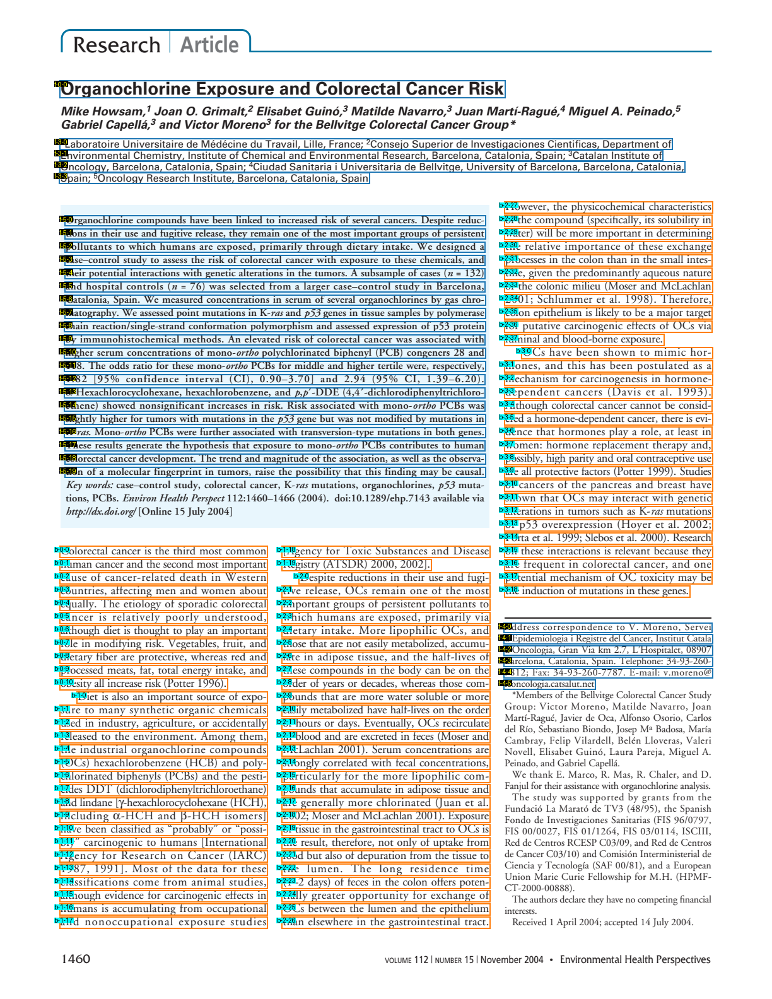

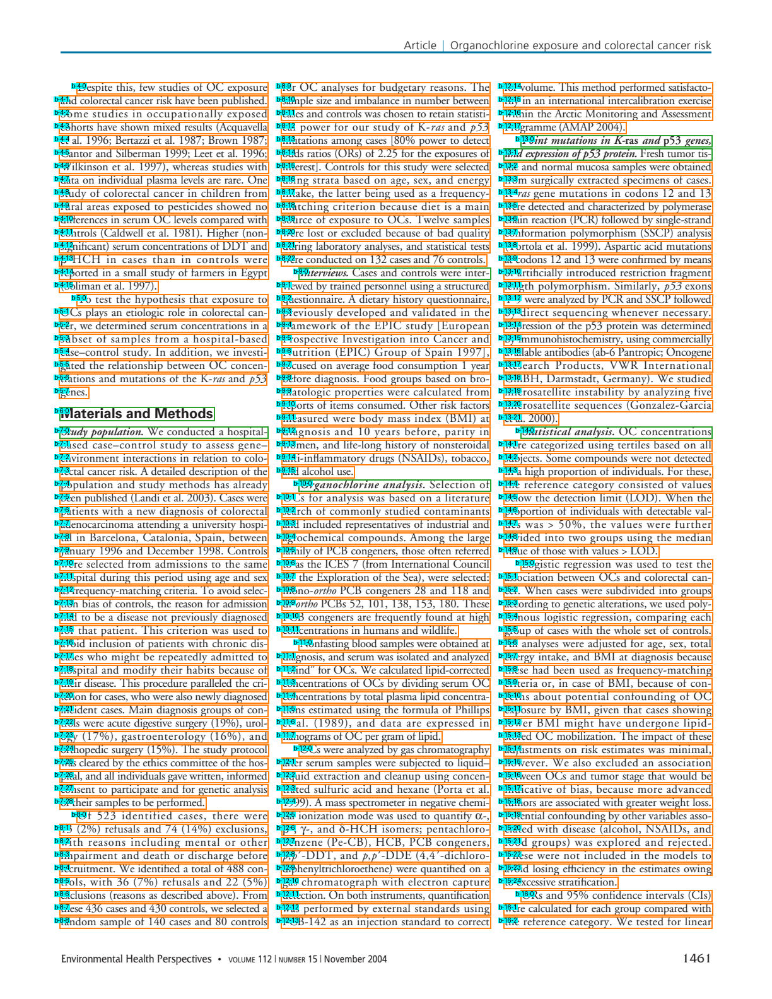

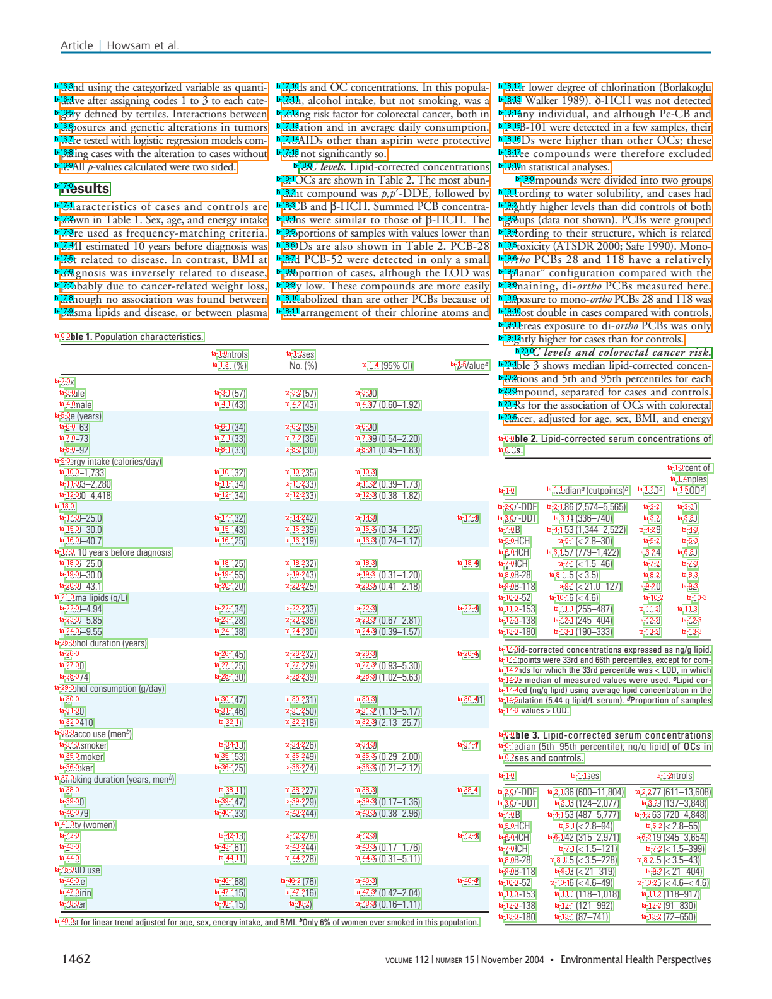

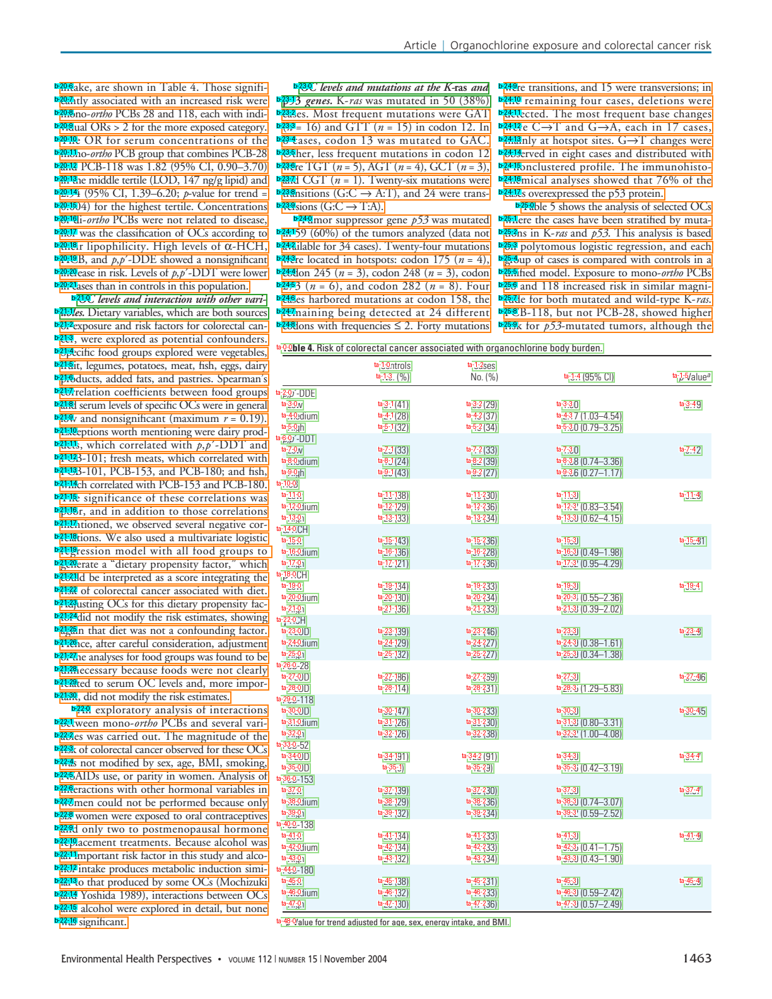

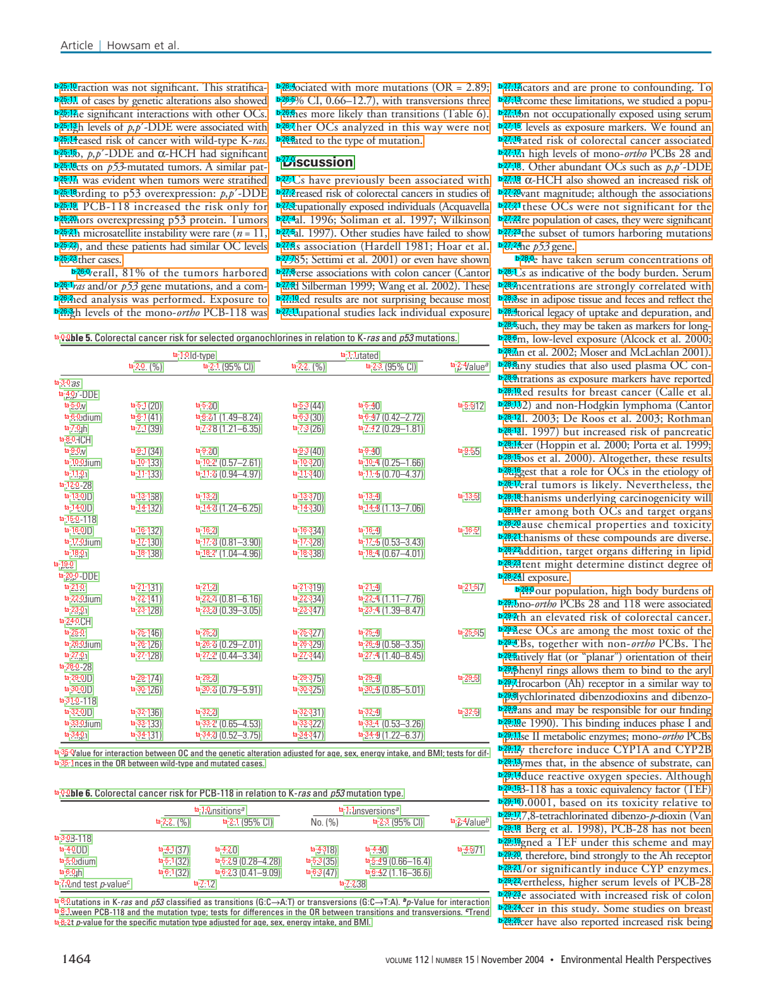

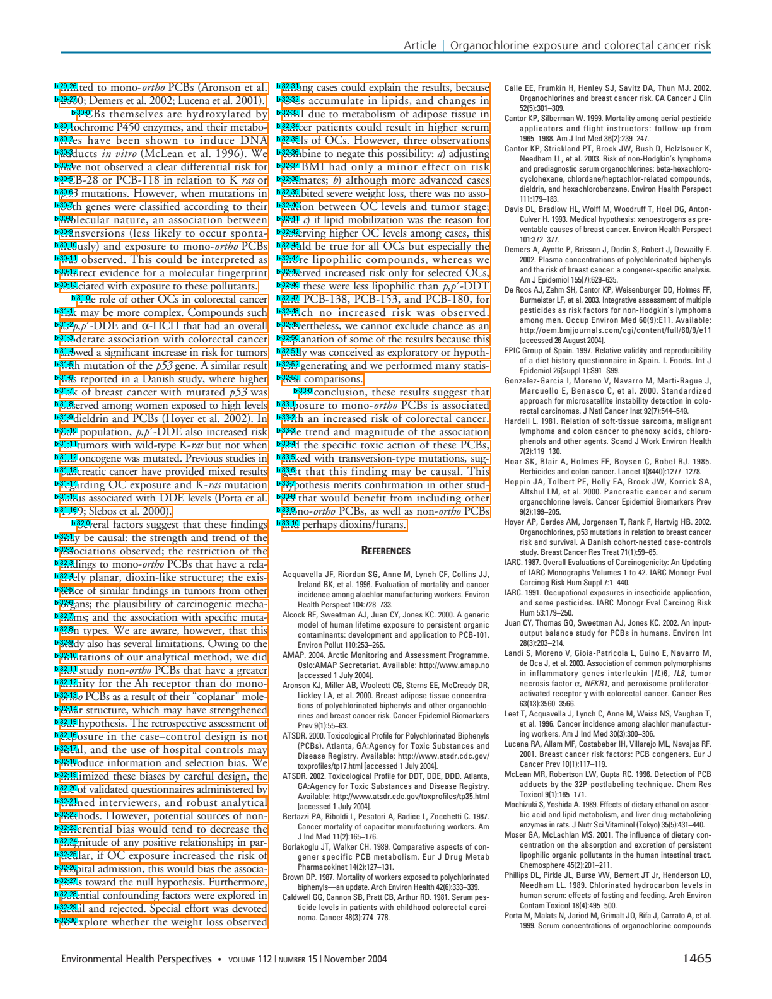

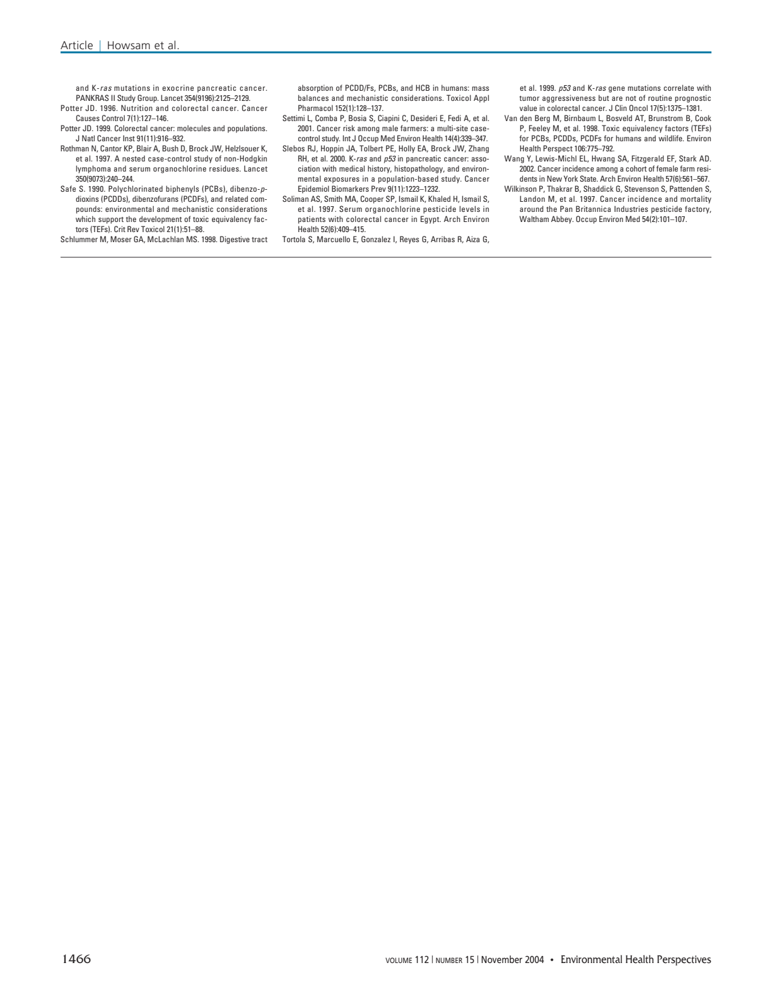

In [95]:
from edspdf.structures import Box, Box_lines, TextBox

pdf = Path(loaded_pmc_data['pdf_path']).read_bytes()
doc_2: PDFDoc = model.get_pipe("extractor")(pdf)

content_boxes = []
for li in loaded_pmc_data['front_lines'] + loaded_pmc_data['body_lines'] + loaded_pmc_data['table_lines']:
    _tb = TextBox(
        x0=li['x0'],
        x1=li['x1'],
        y0=li['y0'],
        y1=li['y1'],
        text=li['text'],
        label=li['label'],
        page_num=li['page_num'],
        )
    if li['node_type'] == 'front':
        _tb.rank = f"{li['node_type'][0]}-{li['node_num']}-{li['rank']}"
        _tb.color='yellow'
        _tb.bg_color='black'
    if li['node_type'] == 'body':
        _tb.rank = f"{li['node_type'][0]}-{li['node_num']}-{li['rank']}"
        _tb.color='black'
        _tb.bg_color='cyan'
    if li['node_type'] == 'table':
        _tb.rank = f"{li['node_type'][:2]}-{li['node_num']}-{li['rank']}"
        _tb.color='red'
        _tb.bg_color='white'
    content_boxes.append(_tb)

for page in show_annotations(doc_2.content, content_boxes):
    display(page)